<a id="top"></a>
<div style="text-align: center; background: #1ED760; font-family: 'Trebuchet MS', Arial, sans-serif; color: white; padding: 15px; font-size: 26px; font-weight: bold; line-height: 1; border-radius: 50% 0 50% 0 / 40px; margin-bottom: 20px; box-shadow: 0px 4px 6px rgba(0, 0, 0, 0.1);">Lab 04</br></br> <I style = "font-size: 20px">by: Ahmed Sharaf</I></div>



## Practical Work 4

For this practical work, the student will have to develop a Python program that is able to implement the accelerated gradient descent methods with adaptive learning rate <b>(Adagrad, RMSProp, and Adam)</b> in order to achieve the linear regression of a set of datapoints.
##### Please notice that we will apply these algorithm to single variable LR.

#### Import numpy, matplotlib.pyplot and make it inline

In [1]:
import numpy as np
import matplotlib.pyplot as plt 
from sklearn.metrics import r2_score
from sklearn.utils import shuffle

%matplotlib inline
np.random.seed(101)

# Visualization Functions

In [2]:
def loss_vs_epochs(losses):
    plt.plot(losses, '-o', color='red')
    plt.title("Loss vs Epochs")
    plt.xlabel("Epochs")
    plt.ylabel("Loss")
    plt.grid(True)
    plt.show()


def thetas_vs_loss(thetas_zero, thetas_one, losses, lr):
    fig, ax = plt.subplots(1, 2, figsize=(15, 6))
    fig.suptitle("Thetas vs Losses")

    ax[0].plot(thetas_zero, losses, '-o')
    ax[0].set_title(f'Theta Zero vs Loss (lr={lr})')
    ax[0].set_xlabel('Theta Zero')
    ax[0].set_ylabel('Loss')
    ax[0].grid(True)

    ax[1].plot(thetas_one, losses, '-o')
    ax[1].set_title(f'Theta One vs Loss (lr={lr})')
    ax[1].set_xlabel('Theta One')
    ax[1].set_ylabel('Loss')
    ax[1].grid(True)

    plt.tight_layout()
    plt.show()

def all_lines(X, y, thetas_zero, thetas_one):
    plt.scatter(X, y, label='Data')

    for i in range(len(thetas_zero)):
        y_hat = thetas_zero[i] + thetas_one[i] * X
        plt.plot(X, y_hat, color='red', alpha=0.3)

    plt.title('Regression Lines at Different Stages')
    plt.xlabel('X')
    plt.ylabel('y')
    plt.grid(True)
    plt.show()


def best_line(X, y, y_pred):
    plt.scatter(X, y, label="Data Points")
    plt.plot(X, y_pred, color='red', linewidth=2, label="Best Fit Line")
    plt.xlabel("X")
    plt.ylabel("y")
    plt.title("Best Fit Line")
    plt.legend()
    plt.grid(True)
    plt.show()


def vis(X, y, y_pred, thetas_zero, thetas_one, losses, lr):
    loss_vs_epochs(losses)
    thetas_vs_loss(thetas_zero, thetas_one, losses, lr)
    all_lines(X, y, thetas_zero, thetas_one)
    best_line(X, y, y_pred)


To have a dataset or set of data points, the student must generate a pair of arrays <b>X</b> and <b>y</b> with the values in <b>X</b> equally distributed between <b>0</b> and <b>20</b> and the values in <b>y</b> such that: 
<b>yi = a*xi + b (and a = -1, b = 2)</b>


In [3]:
X = np.linspace(0,20)
X

array([ 0.        ,  0.40816327,  0.81632653,  1.2244898 ,  1.63265306,
        2.04081633,  2.44897959,  2.85714286,  3.26530612,  3.67346939,
        4.08163265,  4.48979592,  4.89795918,  5.30612245,  5.71428571,
        6.12244898,  6.53061224,  6.93877551,  7.34693878,  7.75510204,
        8.16326531,  8.57142857,  8.97959184,  9.3877551 ,  9.79591837,
       10.20408163, 10.6122449 , 11.02040816, 11.42857143, 11.83673469,
       12.24489796, 12.65306122, 13.06122449, 13.46938776, 13.87755102,
       14.28571429, 14.69387755, 15.10204082, 15.51020408, 15.91836735,
       16.32653061, 16.73469388, 17.14285714, 17.55102041, 17.95918367,
       18.36734694, 18.7755102 , 19.18367347, 19.59183673, 20.        ])

In [4]:
a=-1
b=2
y=a*X+b
y

array([  2.        ,   1.59183673,   1.18367347,   0.7755102 ,
         0.36734694,  -0.04081633,  -0.44897959,  -0.85714286,
        -1.26530612,  -1.67346939,  -2.08163265,  -2.48979592,
        -2.89795918,  -3.30612245,  -3.71428571,  -4.12244898,
        -4.53061224,  -4.93877551,  -5.34693878,  -5.75510204,
        -6.16326531,  -6.57142857,  -6.97959184,  -7.3877551 ,
        -7.79591837,  -8.20408163,  -8.6122449 ,  -9.02040816,
        -9.42857143,  -9.83673469, -10.24489796, -10.65306122,
       -11.06122449, -11.46938776, -11.87755102, -12.28571429,
       -12.69387755, -13.10204082, -13.51020408, -13.91836735,
       -14.32653061, -14.73469388, -15.14285714, -15.55102041,
       -15.95918367, -16.36734694, -16.7755102 , -17.18367347,
       -17.59183673, -18.        ])

#### Plot X vs. y

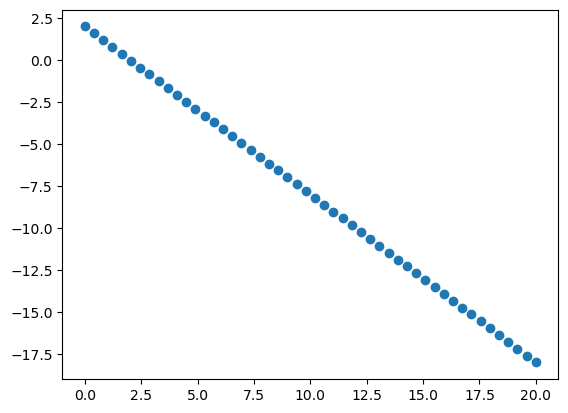

In [5]:
plt.scatter(X, y)
plt.show()

## Adagrad

### For a single variable linear regression ML model, build a function to find the optimum Theta_0 and Theta_1 parameters using Adagrad optimization algorithm.
#### The funtion should have the following input parameters:
##### 1. Input data as a matrix (or vector based on your data).
##### 2. Target label as a vector.
##### 3. Learning rate.
##### 4. Epsilon.
##### 5. Maximum number of iterations (Epochs).
#### The funtion should return the following outputs:
##### 1. All predicted Theta_0 in all iterations.
##### 2. All predicted Theta_1 in all iterations.
##### 3. Corresponding loss for each Theta_0 and Theta_1 predictions.
##### 4.All hypothesis outputs (prdicted labels) for each Theta_0 and Theta_1 predictions.
##### 5.Final Optimum values of Theta_0 and Theta_1.
#### Choose the suitable number of iterations, learning rate, Epsilon, and stop criteria.
#### Calculate r2 score. Shouldn't below 0.9
#### Plot the required curves (loss-epochs, loss-theta0, loss-theta1, all fitted lines per epoch (single graph), best fit line)
#### Try different values of the huperparameters and see the differnce in your results.

##### The following results uses alpha = 0.05, epsilon =  1e-08, and max. iterations = 500.

In [12]:
def adagrad(X, y, lr = 0.01, alpha = 0.9, ellipson = 1e-08 ,itteration = 1000):
    m = len(X)
    theta_0 = 0
    theta_1 = 0
    h = []
    losses = []
    all_theta_0 = []
    all_theta_1 = []
    
    v_t_0 = 0
    v_t_1 = 0
    
    for i in range(itteration):
        print('*' * 10 , f'Iteration {i}', '*' * 10, '\n')
        all_theta_0.append(theta_0)
        all_theta_1.append(theta_1)
        
        y_pred = theta_0 + theta_1 * X
        print(f"h(x):\n{y_pred}")
        h.append(y)
        
        error_vector = y_pred - y
        print(f"Error Vector:\n{error_vector}\n")
        J = np.sum(error_vector ** 2) / (2 * m)
        print(f"J = {J}")
        losses.append(J)
        
        theta_0_grad = np.sum(error_vector) / m
        theta_1_grad = np.sum(error_vector * X) / m
        print(f"theta_0_grad: {theta_0_grad}")
        print(f"theta_1_grad: {theta_1_grad}")
        norm_grad = np.linalg.norm(np.array([theta_0_grad, theta_1_grad]))
        print(f"Norm of Gradient: {norm_grad}")
        if norm_grad < 0.001 or ((i > 1) and (abs(losses[-2] - J) < 0.001)):
            print(f"Converged after {i} iterations")
            break
            
        v_t_0 = v_t_0 + (theta_0_grad ** 2)
        v_t_1 = v_t_1 + (theta_1_grad ** 2)
        
        theta_0 = theta_0 - ( lr / (np.sqrt(v_t_0) + ellipson))  * theta_0_grad
        theta_1 = theta_1 - ( lr / (np.sqrt(v_t_1) + ellipson))  * theta_1_grad 
        print(f"theta_0_new : {theta_0}")
        print(f"theta_1_new : {theta_1}\n")
        
    return theta_0, theta_1, all_theta_0, all_theta_1, losses, h

In [13]:
t0, t1, ts0, ts1, losses, h = adagrad(X, y, lr=0.05, itteration=500)

********** Iteration 0 ********** 

h(x):
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0.]
Error Vector:
[-2.         -1.59183673 -1.18367347 -0.7755102  -0.36734694  0.04081633
  0.44897959  0.85714286  1.26530612  1.67346939  2.08163265  2.48979592
  2.89795918  3.30612245  3.71428571  4.12244898  4.53061224  4.93877551
  5.34693878  5.75510204  6.16326531  6.57142857  6.97959184  7.3877551
  7.79591837  8.20408163  8.6122449   9.02040816  9.42857143  9.83673469
 10.24489796 10.65306122 11.06122449 11.46938776 11.87755102 12.28571429
 12.69387755 13.10204082 13.51020408 13.91836735 14.32653061 14.73469388
 15.14285714 15.55102041 15.95918367 16.36734694 16.7755102  17.18367347
 17.59183673 18.        ]

J = 49.34693877551021
theta_0_grad: 8.0
theta_1_grad: 114.69387755102042
Norm of Gradient: 114.97254258164628
theta_0_new : -0.0499999999375
theta_1_new : -0.04999999999564057

***

In [14]:
y_pred = t0 + t1 * X
print(f"r2_score = {r2_score(y, y_pred)}")

r2_score = 0.9484638125790851


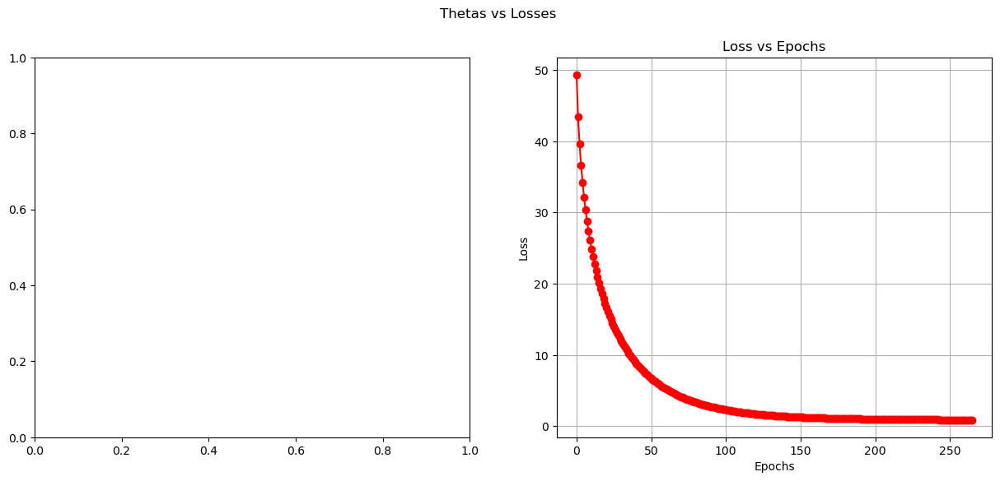

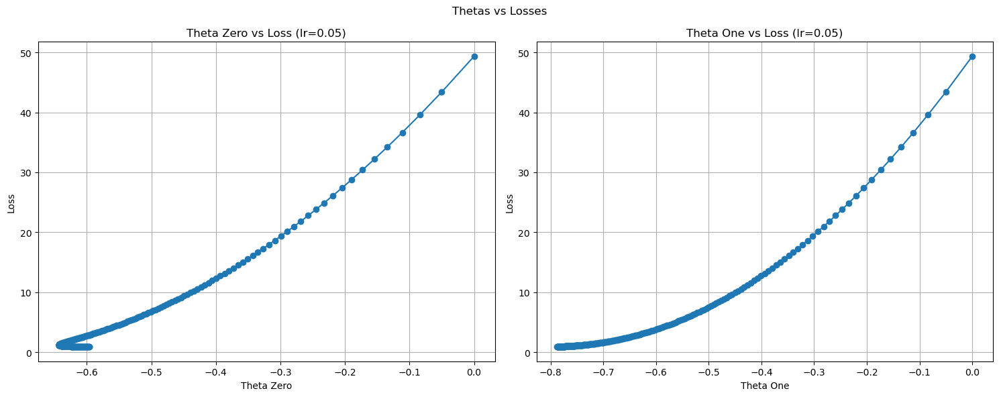

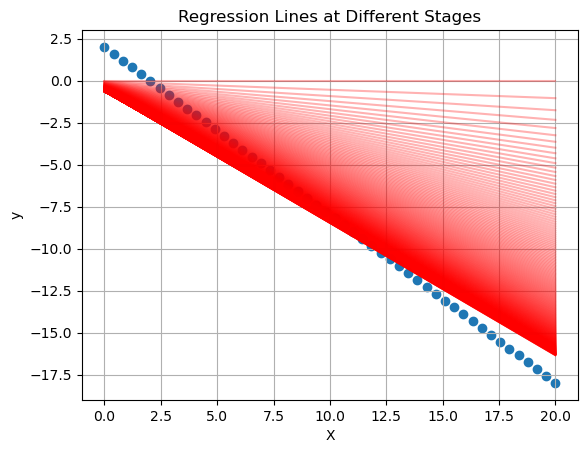

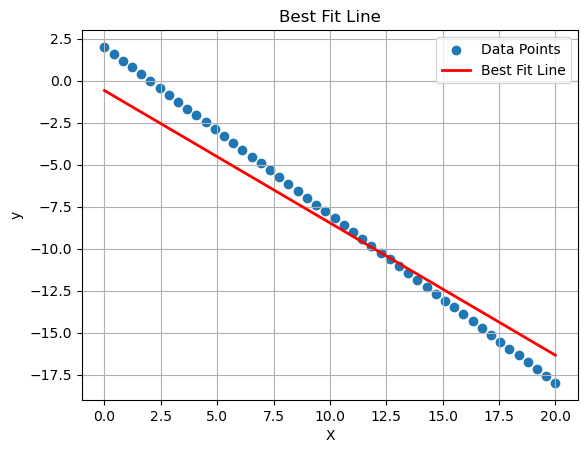

In [15]:
vis(X, y, y_pred, ts0, ts1, losses, lr=0.05)

##### The following results uses alpha = 0.005, epsilon =  1e-08, and max. iterations = 5000.

In [16]:
t0, t1, ts0, ts1, losses, h = adagrad(X, y, lr=0.005, itteration=5000)

********** Iteration 0 ********** 

h(x):
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0.]
Error Vector:
[-2.         -1.59183673 -1.18367347 -0.7755102  -0.36734694  0.04081633
  0.44897959  0.85714286  1.26530612  1.67346939  2.08163265  2.48979592
  2.89795918  3.30612245  3.71428571  4.12244898  4.53061224  4.93877551
  5.34693878  5.75510204  6.16326531  6.57142857  6.97959184  7.3877551
  7.79591837  8.20408163  8.6122449   9.02040816  9.42857143  9.83673469
 10.24489796 10.65306122 11.06122449 11.46938776 11.87755102 12.28571429
 12.69387755 13.10204082 13.51020408 13.91836735 14.32653061 14.73469388
 15.14285714 15.55102041 15.95918367 16.36734694 16.7755102  17.18367347
 17.59183673 18.        ]

J = 49.34693877551021
theta_0_grad: 8.0
theta_1_grad: 114.69387755102042
Norm of Gradient: 114.97254258164628
theta_0_new : -0.00499999999375
theta_1_new : -0.004999999999564057

*

In [17]:
y_pred = t0 + t1 * X
print(f"r2_score = {r2_score(y, y_pred)}")

r2_score = 0.7096780137749918


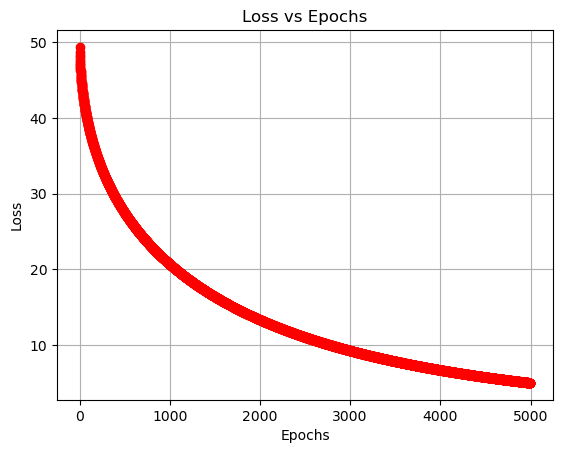

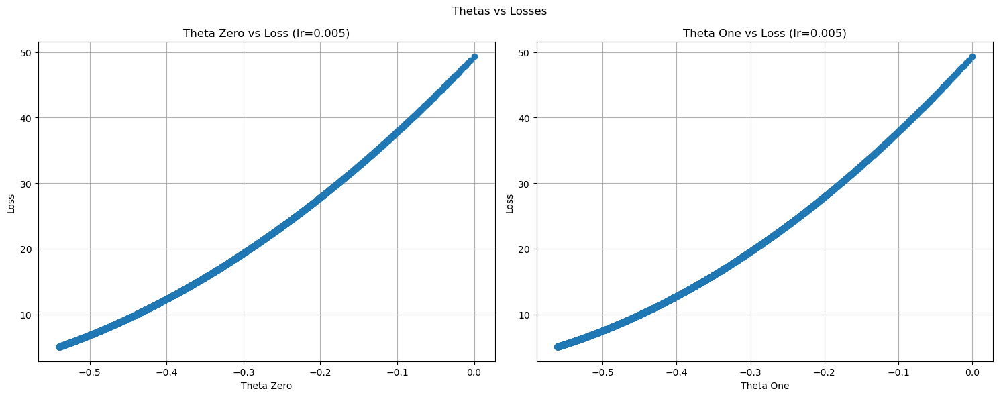

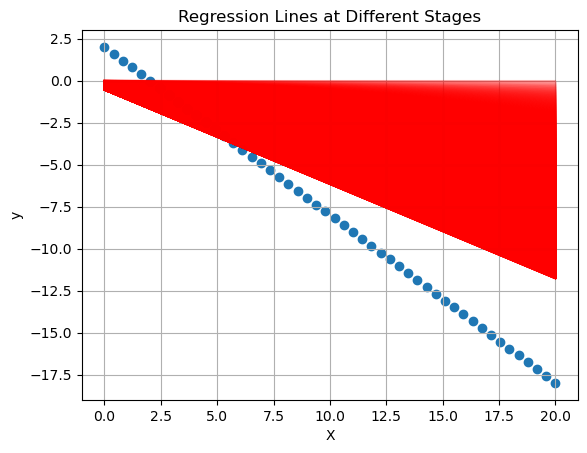

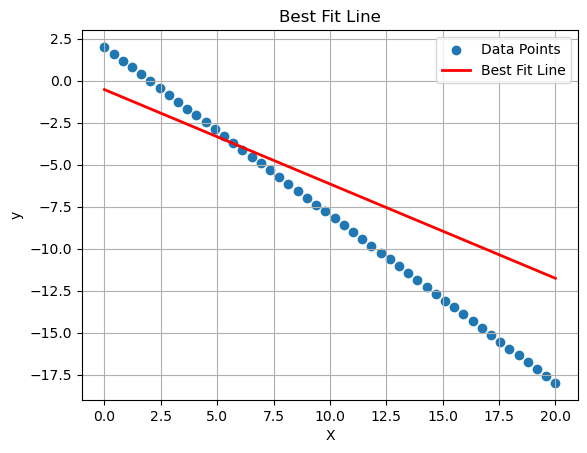

In [18]:
vis(X, y, y_pred, ts0, ts1, losses, lr=0.005)

##### The following results uses alpha = 0.0005, epsilon =  1e-08, and max. iterations = 5000.

In [19]:
t0, t1, ts0, ts1, losses, h = adagrad(X, y, lr=0.0005, itteration=5000)

********** Iteration 0 ********** 

h(x):
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0.]
Error Vector:
[-2.         -1.59183673 -1.18367347 -0.7755102  -0.36734694  0.04081633
  0.44897959  0.85714286  1.26530612  1.67346939  2.08163265  2.48979592
  2.89795918  3.30612245  3.71428571  4.12244898  4.53061224  4.93877551
  5.34693878  5.75510204  6.16326531  6.57142857  6.97959184  7.3877551
  7.79591837  8.20408163  8.6122449   9.02040816  9.42857143  9.83673469
 10.24489796 10.65306122 11.06122449 11.46938776 11.87755102 12.28571429
 12.69387755 13.10204082 13.51020408 13.91836735 14.32653061 14.73469388
 15.14285714 15.55102041 15.95918367 16.36734694 16.7755102  17.18367347
 17.59183673 18.        ]

J = 49.34693877551021
theta_0_grad: 8.0
theta_1_grad: 114.69387755102042
Norm of Gradient: 114.97254258164628
theta_0_new : -0.000499999999375
theta_1_new : -0.0004999999999564057


In [20]:
y_pred = t0 + t1 * X
print(f"r2_score = {r2_score(y, y_pred)}")

r2_score = -1.4736441832884104


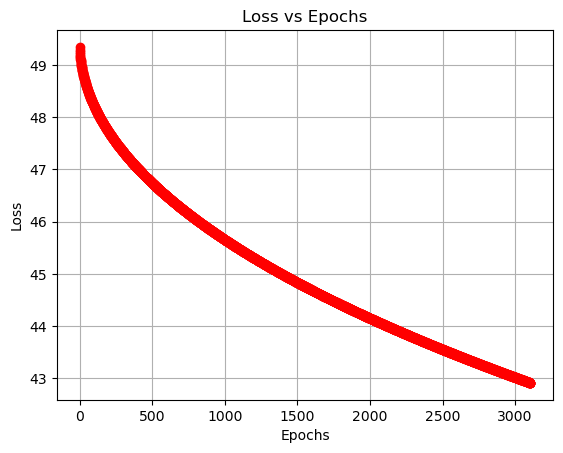

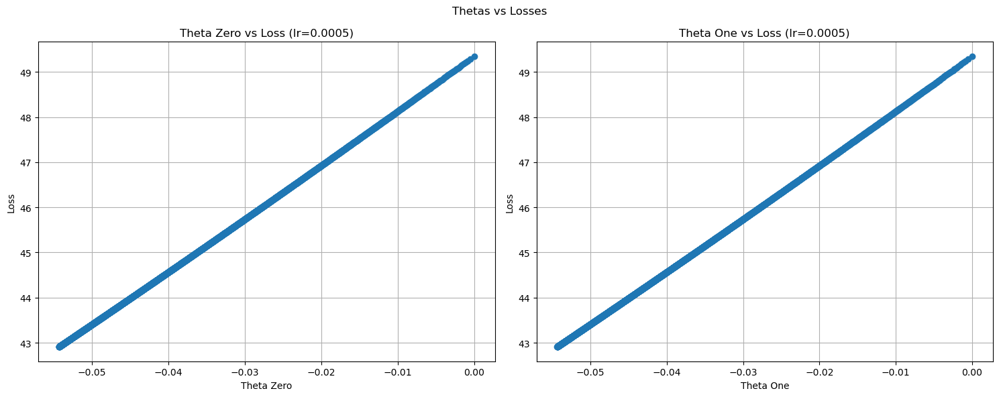

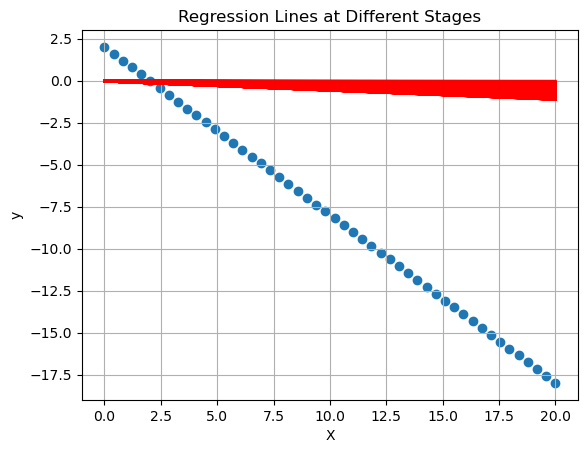

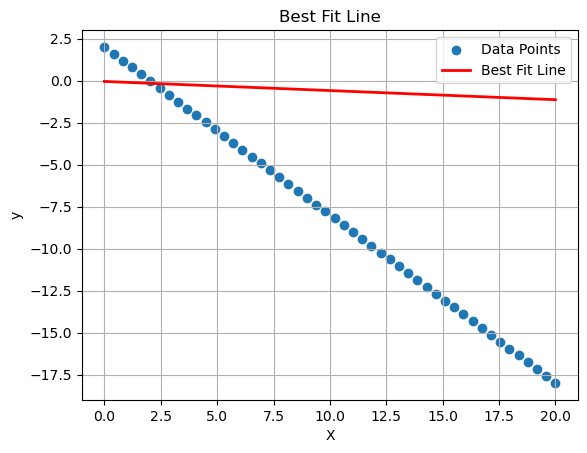

In [21]:
vis(X, y, y_pred, ts0, ts1, losses, lr=0.0005)

## RMSProp

### Update the previos implementation to be RMSProp.
#### Compare your results with Adagrad results.

In [24]:
def rmsprop(X, y, alpha = 0.01, beta = 0.9, ellipson = 1e-08 ,itteration = 1000):
    m = len(X)
    theta_0 = 0
    theta_1 = 0
    h = []
    losses = []
    all_theta_0 = []
    all_theta_1 = []
    
    v_t_0 = 0
    v_t_1 = 0
    
    for i in range(itteration):
        print('*' * 10 , f'Iteration {i}', '*' * 10, '\n')
        all_theta_0.append(theta_0)
        all_theta_1.append(theta_1)
        
        y_pred = theta_0 + theta_1 * X
        print(f"h(x):\n{y_pred}")
        h.append(y)
        
        error_vector = y_pred - y
        print(f"Error Vector:\n{error_vector}")
        J = np.sum(error_vector ** 2) / (2 * m)
        print(f"J = {J}")
        losses.append(J)
        
        theta_0_grad = np.sum(error_vector) / m
        theta_1_grad = np.sum(error_vector * X) / m
        print(f"theta_0_grad: {theta_0_grad}")
        print(f"theta_1_grad: {theta_1_grad}")
        norm_grad = np.linalg.norm(np.array([theta_0_grad, theta_1_grad]))
        
        if norm_grad < 0.001 or ((i > 1) and (abs(losses[-2] - J) < 0.001)):
            print(f"Converged after {i} iterations")
            break
            
        v_t_0 = (beta * v_t_0) + (1 - beta) * (theta_0_grad ** 2)
        v_t_1 = (beta * v_t_1) + (1 - beta) * (theta_1_grad ** 2)
        
        theta_0 = theta_0 - ( alpha / (np.sqrt(v_t_0) + ellipson))  * theta_0_grad
        theta_1 = theta_1 - ( alpha / (np.sqrt(v_t_1) + ellipson))  * theta_1_grad 
        print(f"theta_0_new : {theta_0}")
        print(f"theta_1_new : {theta_1}")

    return theta_0, theta_1, all_theta_0, all_theta_1, losses, h

##### The following results uses alpha = 0.05, beta = 0.9, epsilon =  1e-08, and max. iterations = 500.

In [25]:
t0, t1, ts0, ts1, losses, h = rmsprop(X, y, alpha = 0.05, beta = 0.9, itteration=500)

********** Iteration 0 ********** 

h(x):
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0.]
Error Vector:
[-2.         -1.59183673 -1.18367347 -0.7755102  -0.36734694  0.04081633
  0.44897959  0.85714286  1.26530612  1.67346939  2.08163265  2.48979592
  2.89795918  3.30612245  3.71428571  4.12244898  4.53061224  4.93877551
  5.34693878  5.75510204  6.16326531  6.57142857  6.97959184  7.3877551
  7.79591837  8.20408163  8.6122449   9.02040816  9.42857143  9.83673469
 10.24489796 10.65306122 11.06122449 11.46938776 11.87755102 12.28571429
 12.69387755 13.10204082 13.51020408 13.91836735 14.32653061 14.73469388
 15.14285714 15.55102041 15.95918367 16.36734694 16.7755102  17.18367347
 17.59183673 18.        ]
J = 49.34693877551021
theta_0_grad: 8.0
theta_1_grad: 114.69387755102042
theta_0_new : -0.158113882383419
theta_1_new : -0.1581138829648247
********** Iteration 1 ********** 

h(x):

In [26]:
y_pred = t0 + t1 * X
print(f"r2_score = {r2_score(y, y_pred)}")

r2_score = 0.9993602095484933


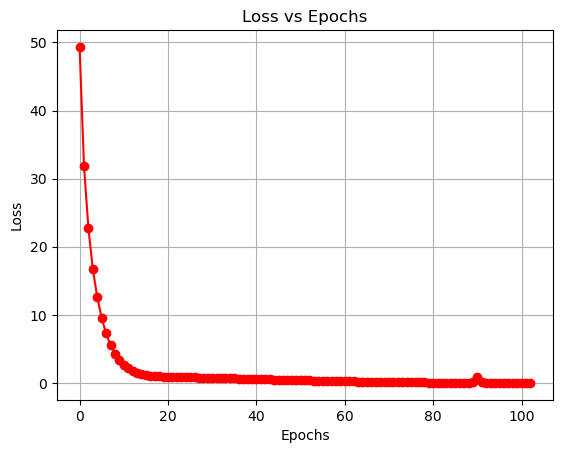

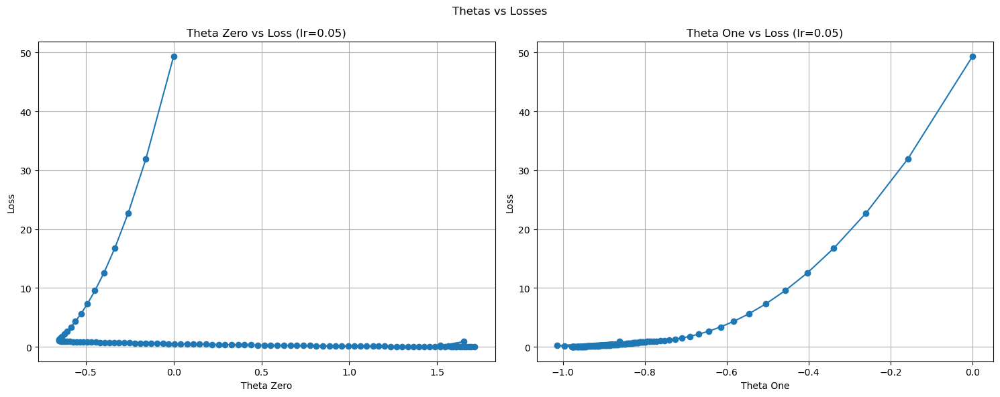

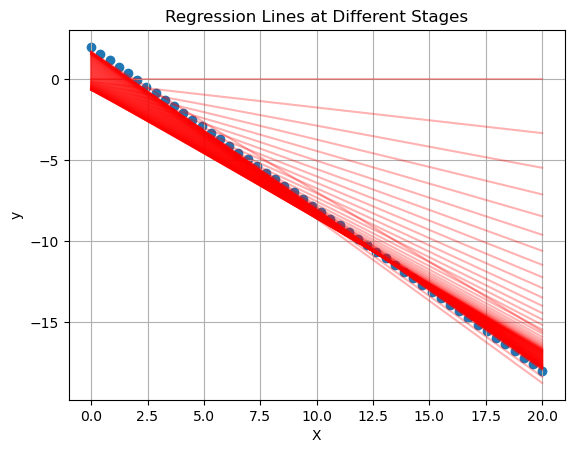

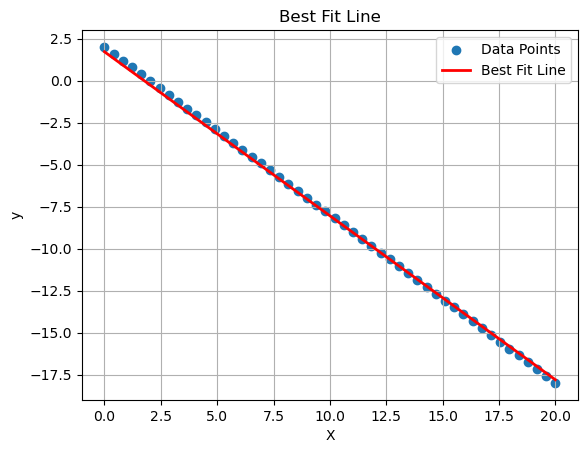

In [27]:
vis(X, y, y_pred, ts0, ts1, losses, lr=0.05)

##### The following results uses alpha = 0.005, beta = 0.9, epsilon =  1e-08, and max. iterations = 5000.

In [28]:
t0, t1, ts0, ts1, losses, h = rmsprop(X, y, alpha = 0.005, beta = 0.9, itteration=5000)

********** Iteration 0 ********** 

h(x):
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0.]
Error Vector:
[-2.         -1.59183673 -1.18367347 -0.7755102  -0.36734694  0.04081633
  0.44897959  0.85714286  1.26530612  1.67346939  2.08163265  2.48979592
  2.89795918  3.30612245  3.71428571  4.12244898  4.53061224  4.93877551
  5.34693878  5.75510204  6.16326531  6.57142857  6.97959184  7.3877551
  7.79591837  8.20408163  8.6122449   9.02040816  9.42857143  9.83673469
 10.24489796 10.65306122 11.06122449 11.46938776 11.87755102 12.28571429
 12.69387755 13.10204082 13.51020408 13.91836735 14.32653061 14.73469388
 15.14285714 15.55102041 15.95918367 16.36734694 16.7755102  17.18367347
 17.59183673 18.        ]
J = 49.34693877551021
theta_0_grad: 8.0
theta_1_grad: 114.69387755102042
theta_0_new : -0.0158113882383419
theta_1_new : -0.01581138829648247
********** Iteration 1 ********** 

h(x

In [29]:
y_pred = t0 + t1 * X
print(f"r2_score = {r2_score(y, y_pred)}")

r2_score = 0.9948527107478715


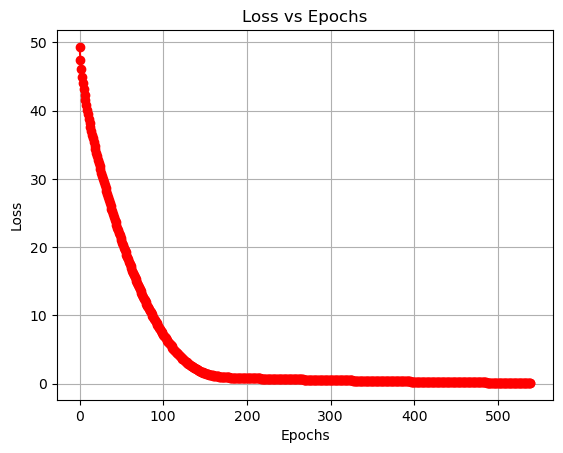

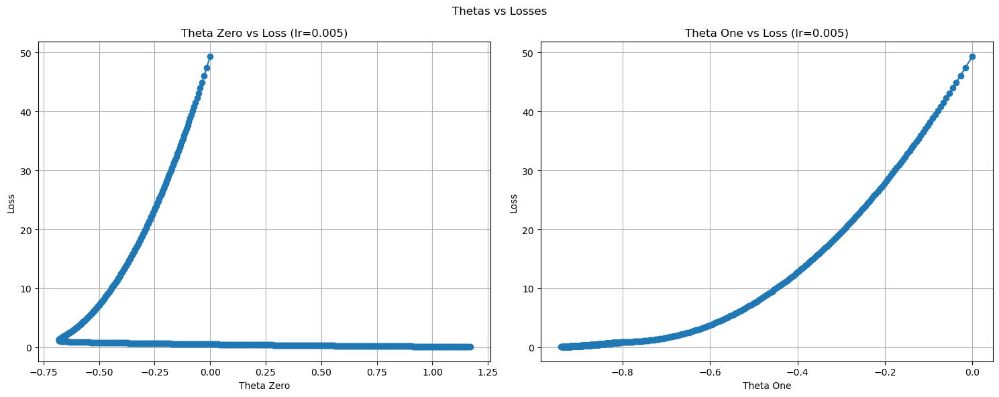

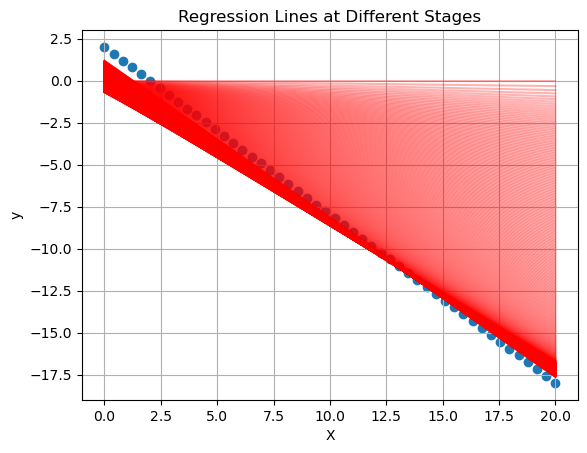

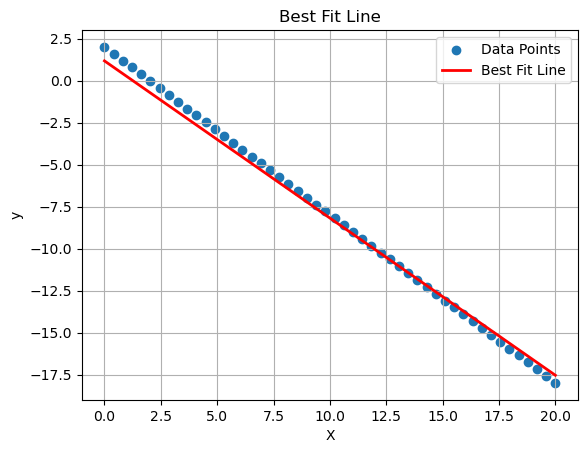

In [30]:
vis(X, y, y_pred, ts0, ts1, losses, lr=0.005)

##### The following results uses alpha = 0.0005, beta = 0.9, epsilon =  1e-08, and max. iterations = 5000.

In [31]:
t0, t1, ts0, ts1, losses, h = rmsprop(X, y, alpha = 0.0005, beta = 0.9, itteration=5000)

********** Iteration 0 ********** 

h(x):
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0.]
Error Vector:
[-2.         -1.59183673 -1.18367347 -0.7755102  -0.36734694  0.04081633
  0.44897959  0.85714286  1.26530612  1.67346939  2.08163265  2.48979592
  2.89795918  3.30612245  3.71428571  4.12244898  4.53061224  4.93877551
  5.34693878  5.75510204  6.16326531  6.57142857  6.97959184  7.3877551
  7.79591837  8.20408163  8.6122449   9.02040816  9.42857143  9.83673469
 10.24489796 10.65306122 11.06122449 11.46938776 11.87755102 12.28571429
 12.69387755 13.10204082 13.51020408 13.91836735 14.32653061 14.73469388
 15.14285714 15.55102041 15.95918367 16.36734694 16.7755102  17.18367347
 17.59183673 18.        ]
J = 49.34693877551021
theta_0_grad: 8.0
theta_1_grad: 114.69387755102042
theta_0_new : -0.00158113882383419
theta_1_new : -0.001581138829648247
********** Iteration 1 ********** 

h

In [33]:
y_pred = t0 + t1 * X
print(f"r2_score = {r2_score(y, y_pred)}")

r2_score = 0.9476184845511563


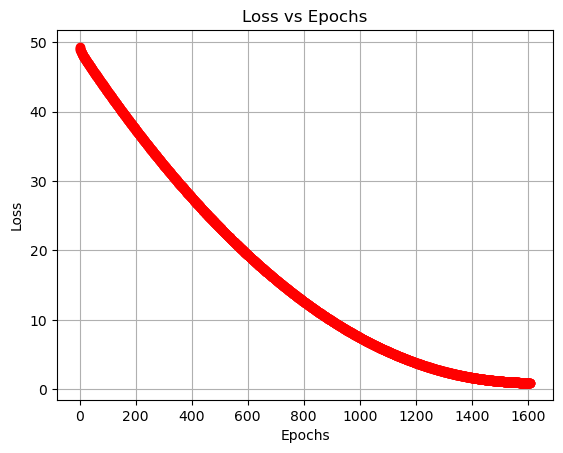

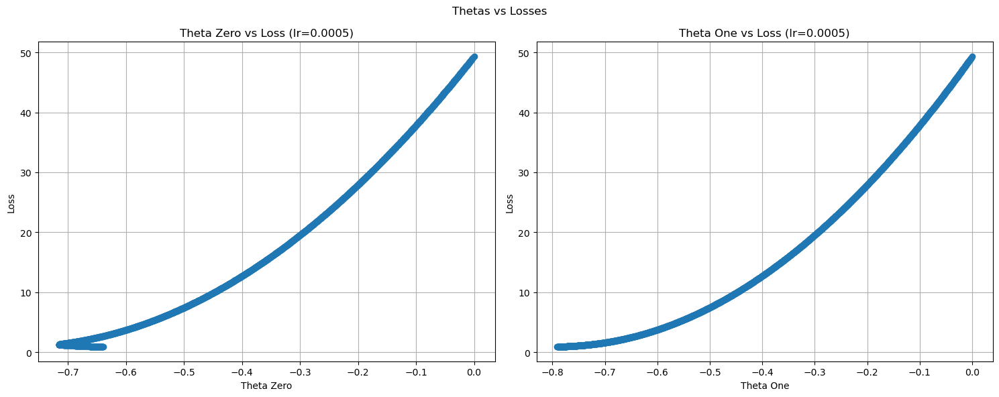

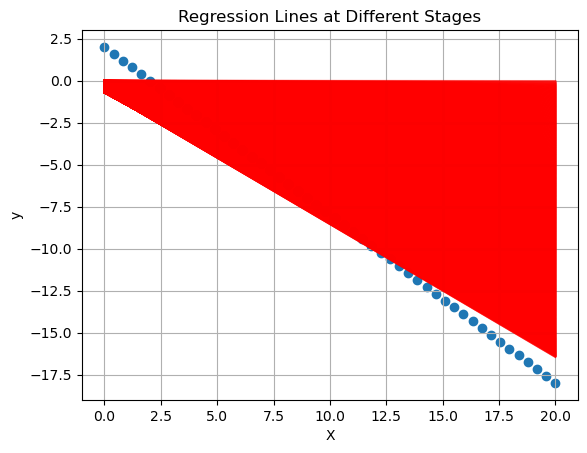

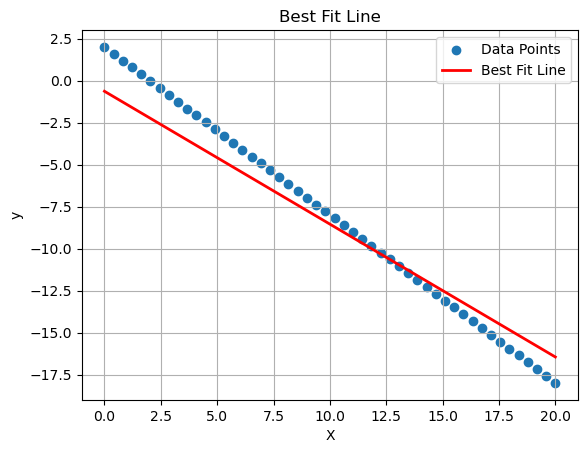

In [34]:
vis(X, y, y_pred, ts0, ts1, losses, lr=0.0005)

## Adam

### Update the previos implementation to be Adam.
#### Compare your results with Adagrad and RMSProp results.

In [35]:
def adam(X, y, alpha = 0.01, beta1 = 0.9, beta2 = 0.9, ellipson = 1e-08 ,itteration = 1000):
    m = len(X)
    theta_0 = 0
    theta_1 = 0
    h = []
    losses = []
    all_theta_0 = []
    all_theta_1 = []
    
    m_t_0 = 0
    m_t_1 = 0
    
    v_t_0 = 0
    v_t_1 = 0
    
    for i in range(itteration):
        print('*' * 10 , f'Iteration {i}', '*' * 10, '\n')
        all_theta_0.append(theta_0)
        all_theta_1.append(theta_1)
        
        y_pred = theta_0 + theta_1 * X
        print(f"h(x):\n{y_pred}")
        h.append(y)
        
        error_vector = y_pred - y
        print(f"Error Vector:\n{error_vector}")
        J = np.sum(error_vector ** 2) / (2 * m)
        print(f"J = {J}")
        losses.append(J)
        
        theta_0_grad = np.sum(error_vector) / m
        theta_1_grad = np.sum(error_vector * X) / m
        print(f"theta_0_grad: {theta_0_grad}")
        print(f"theta_1_grad: {theta_1_grad}")
        norm_grad = np.linalg.norm(np.array([theta_0_grad, theta_1_grad]))
        
        if norm_grad < 0.001 or ((i > 1) and (abs(losses[-2] - J) < 0.001)):
            print(f"Converged after {i} iterations")
            break
        
        m_t_0 = (beta1 * m_t_0) + (1 - beta1) * (theta_0_grad)
        m_t_1 = (beta1 * m_t_1) + (1 - beta1) * (theta_1_grad)
            
        v_t_0 = (beta2 * v_t_0) + (1 - beta2) * (theta_0_grad ** 2)
        v_t_1 = (beta2 * v_t_1) + (1 - beta2) * (theta_1_grad ** 2)
        
        m_hat_0 = m_t_0 / (1 - (beta1 ** (i + 1)))
        m_hat_1 = m_t_1 / (1 - (beta1 ** (i + 1)))
        
        v_hat_0 = v_t_0 / (1 - (beta2 ** (i + 1)))
        v_hat_1 = v_t_1 / (1 - (beta2 ** (i + 1)))
        
        theta_0 = theta_0 - ( alpha / (np.sqrt(v_hat_0) + ellipson))  * m_hat_0
        theta_1 = theta_1 - ( alpha / (np.sqrt(v_hat_1) + ellipson))  * m_hat_1 
        print(f"theta_0_new : {theta_0}")
        print(f"theta_1_new : {theta_1}\n")
        
    return theta_0, theta_1, all_theta_0, all_theta_1, losses, h

##### The following results uses alpha = 0.05, beta1 = 0.2, beta2 = 0.7, epsilon =  1e-08, and max. iterations = 500.

In [36]:
t0, t1, ts0, ts1, losses, h = adam(X, y, alpha = 0.05, beta1= 0.2 , beta2= 0.7, itteration=500)

********** Iteration 0 ********** 

h(x):
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0.]
Error Vector:
[-2.         -1.59183673 -1.18367347 -0.7755102  -0.36734694  0.04081633
  0.44897959  0.85714286  1.26530612  1.67346939  2.08163265  2.48979592
  2.89795918  3.30612245  3.71428571  4.12244898  4.53061224  4.93877551
  5.34693878  5.75510204  6.16326531  6.57142857  6.97959184  7.3877551
  7.79591837  8.20408163  8.6122449   9.02040816  9.42857143  9.83673469
 10.24489796 10.65306122 11.06122449 11.46938776 11.87755102 12.28571429
 12.69387755 13.10204082 13.51020408 13.91836735 14.32653061 14.73469388
 15.14285714 15.55102041 15.95918367 16.36734694 16.7755102  17.18367347
 17.59183673 18.        ]
J = 49.34693877551021
theta_0_grad: 8.0
theta_1_grad: 114.69387755102042
theta_0_new : -0.0499999999375
theta_1_new : -0.04999999999564057

********** Iteration 1 ********** 

h(x):

In [37]:
y_pred = t0 + t1 * X
print(f"r2_score = {r2_score(y, y_pred)}")

r2_score = 0.9989675218213927


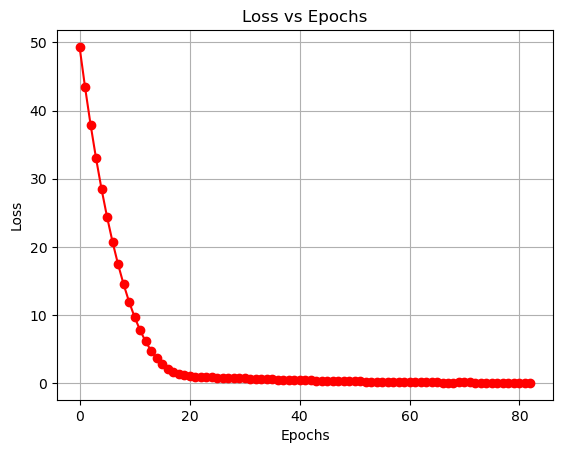

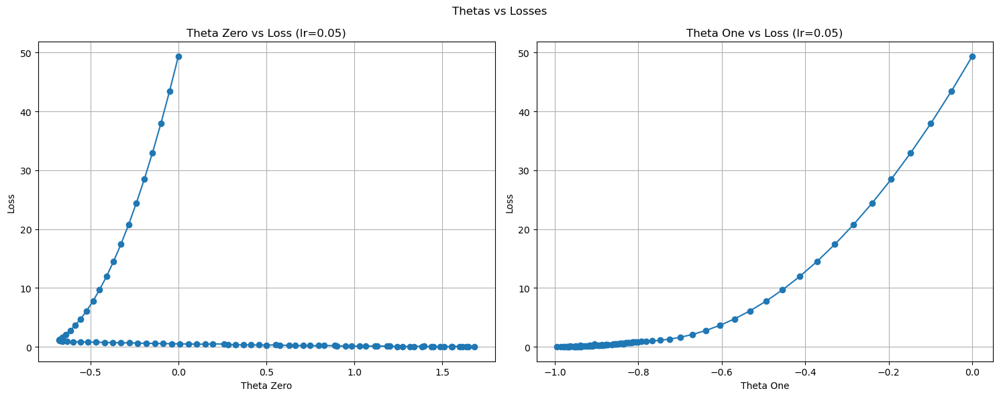

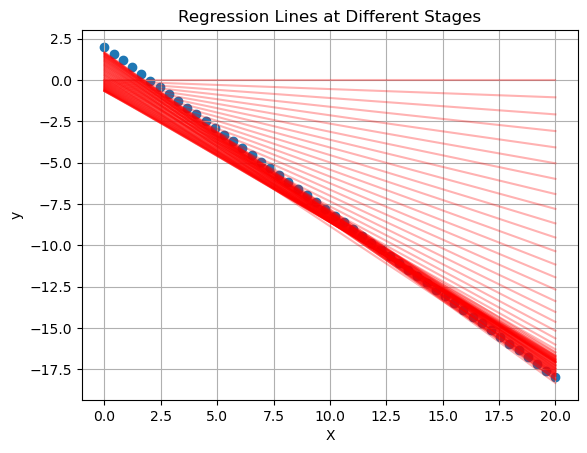

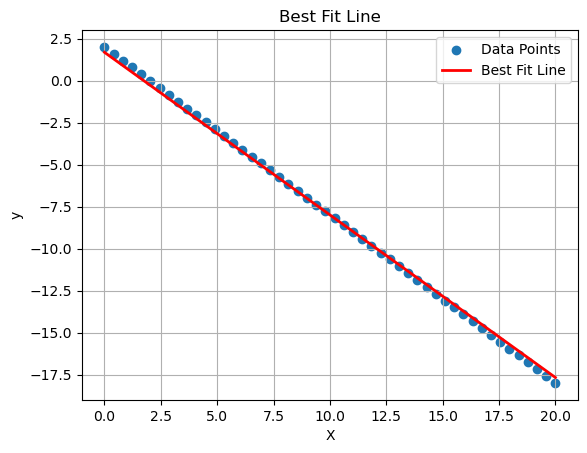

In [38]:
vis(X, y, y_pred, ts0, ts1, losses, lr=0.05)

##### The following results uses alpha = 0.005, beta1 = 0.5, beta2 = 0.8, epsilon =  1e-08, and max. iterations = 500.

In [39]:
t0, t1, ts0, ts1, losses, h = adam(X, y, alpha = 0.005, beta1= 0.5 , beta2= 0.8, itteration=500)

********** Iteration 0 ********** 

h(x):
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0.]
Error Vector:
[-2.         -1.59183673 -1.18367347 -0.7755102  -0.36734694  0.04081633
  0.44897959  0.85714286  1.26530612  1.67346939  2.08163265  2.48979592
  2.89795918  3.30612245  3.71428571  4.12244898  4.53061224  4.93877551
  5.34693878  5.75510204  6.16326531  6.57142857  6.97959184  7.3877551
  7.79591837  8.20408163  8.6122449   9.02040816  9.42857143  9.83673469
 10.24489796 10.65306122 11.06122449 11.46938776 11.87755102 12.28571429
 12.69387755 13.10204082 13.51020408 13.91836735 14.32653061 14.73469388
 15.14285714 15.55102041 15.95918367 16.36734694 16.7755102  17.18367347
 17.59183673 18.        ]
J = 49.34693877551021
theta_0_grad: 8.0
theta_1_grad: 114.69387755102042
theta_0_new : -0.00499999999375
theta_1_new : -0.004999999999564057

********** Iteration 1 ********** 

h(x

In [40]:
y_pred = t0 + t1 * X
print(f"r2_score = {r2_score(y, y_pred)}")

r2_score = 0.9927017859640472


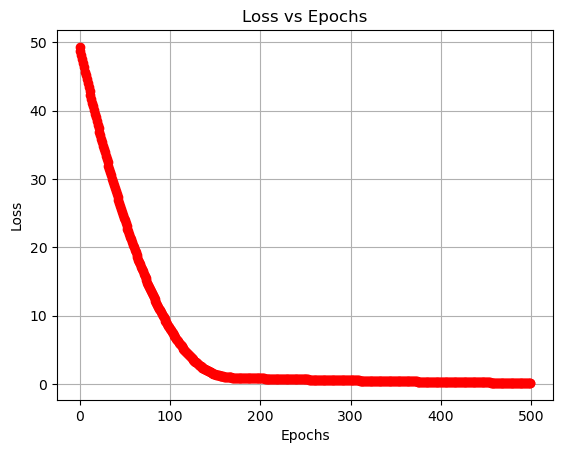

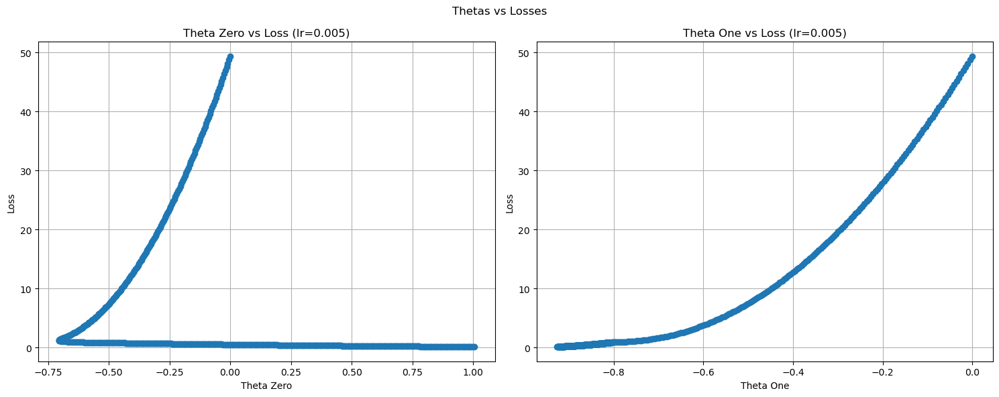

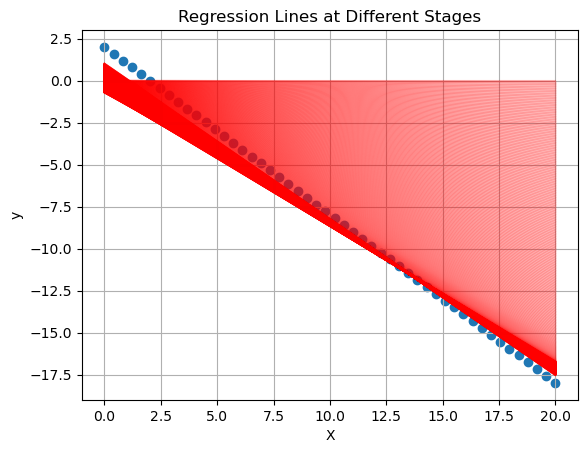

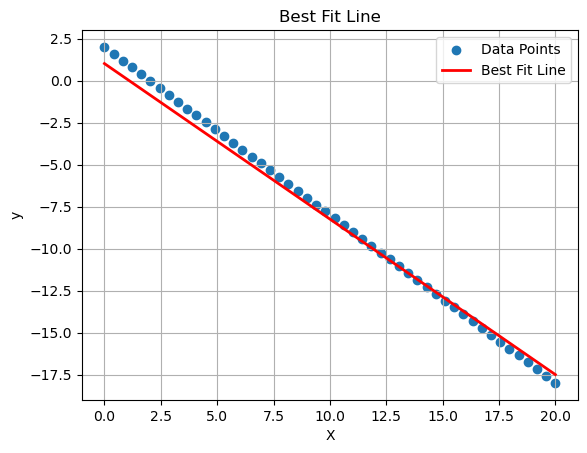

In [41]:
vis(X, y, y_pred, ts0, ts1, losses, lr=0.005)

##### The following results uses alpha = 0.0005, beta1 = 0.8, beta2 = 0.8, epsilon =  1e-08, and max. iterations = 5000.

In [42]:
t0, t1, ts0, ts1, losses, h = adam(X, y, alpha = 0.0005, beta1= 0.8 , beta2= 0.8, itteration=5000)

********** Iteration 0 ********** 

h(x):
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0.]
Error Vector:
[-2.         -1.59183673 -1.18367347 -0.7755102  -0.36734694  0.04081633
  0.44897959  0.85714286  1.26530612  1.67346939  2.08163265  2.48979592
  2.89795918  3.30612245  3.71428571  4.12244898  4.53061224  4.93877551
  5.34693878  5.75510204  6.16326531  6.57142857  6.97959184  7.3877551
  7.79591837  8.20408163  8.6122449   9.02040816  9.42857143  9.83673469
 10.24489796 10.65306122 11.06122449 11.46938776 11.87755102 12.28571429
 12.69387755 13.10204082 13.51020408 13.91836735 14.32653061 14.73469388
 15.14285714 15.55102041 15.95918367 16.36734694 16.7755102  17.18367347
 17.59183673 18.        ]
J = 49.34693877551021
theta_0_grad: 8.0
theta_1_grad: 114.69387755102042
theta_0_new : -0.000499999999375
theta_1_new : -0.0004999999999564057

********** Iteration 1 ********** 

h

In [43]:
y_pred = t0 + t1 * X
print(f"r2_score = {r2_score(y, y_pred)}")

r2_score = 0.9467806664066584


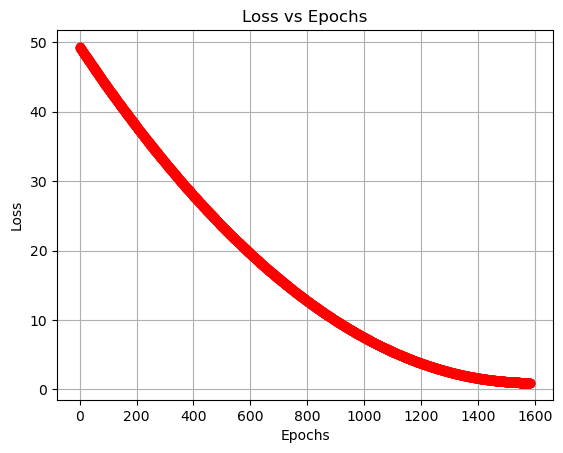

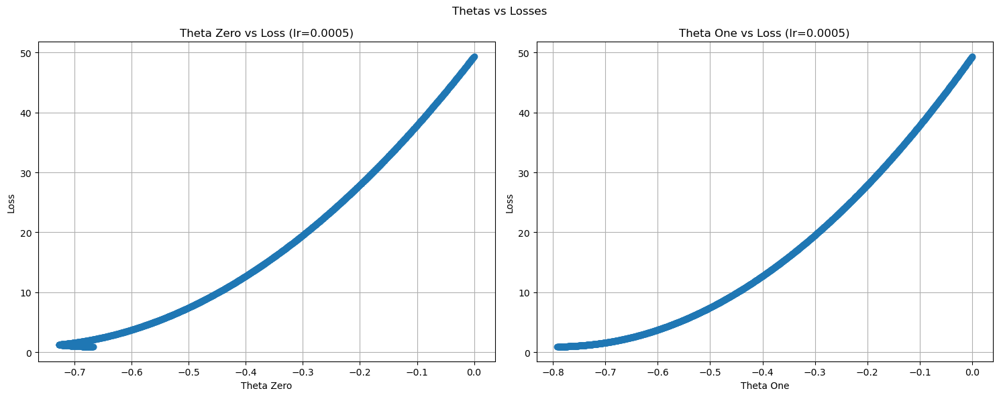

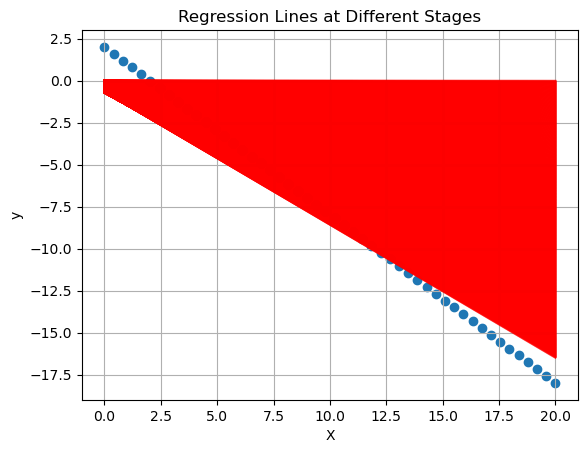

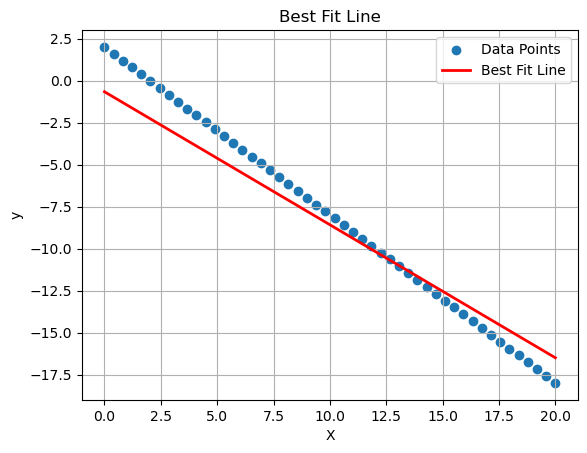

In [44]:
vis(X, y, y_pred, ts0, ts1, losses, lr=0.0005)

### Play with the parameters and see the results

##### The following results uses alpha = 0.001, beta1 = 0.9, beta2 = 0.99, epsilon =  1e-08, and max. iterations = 5000.

In [45]:
t0, t1, ts0, ts1, losses, h = adam(X, y, alpha = 0.001, beta1= 0.9 , beta2= 0.99, itteration=5000)

********** Iteration 0 ********** 

h(x):
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0.]
Error Vector:
[-2.         -1.59183673 -1.18367347 -0.7755102  -0.36734694  0.04081633
  0.44897959  0.85714286  1.26530612  1.67346939  2.08163265  2.48979592
  2.89795918  3.30612245  3.71428571  4.12244898  4.53061224  4.93877551
  5.34693878  5.75510204  6.16326531  6.57142857  6.97959184  7.3877551
  7.79591837  8.20408163  8.6122449   9.02040816  9.42857143  9.83673469
 10.24489796 10.65306122 11.06122449 11.46938776 11.87755102 12.28571429
 12.69387755 13.10204082 13.51020408 13.91836735 14.32653061 14.73469388
 15.14285714 15.55102041 15.95918367 16.36734694 16.7755102  17.18367347
 17.59183673 18.        ]
J = 49.34693877551021
theta_0_grad: 8.0
theta_1_grad: 114.69387755102042
theta_0_new : -0.00099999999875
theta_1_new : -0.0009999999999128113

********** Iteration 1 ********** 

h(

In [46]:
y_pred = t0 + t1 * X
print(f"r2_score = {r2_score(y, y_pred)}")

r2_score = 0.9485667803280174


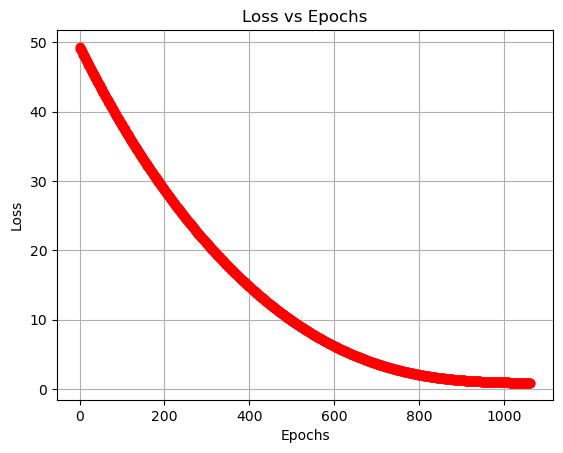

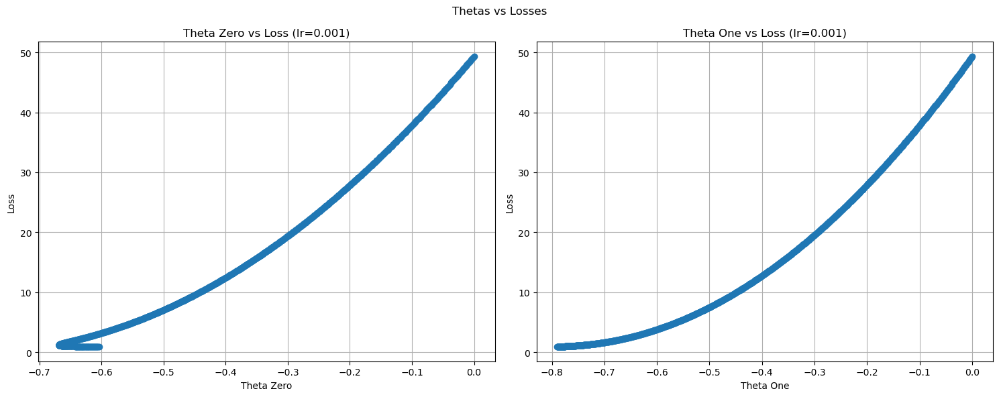

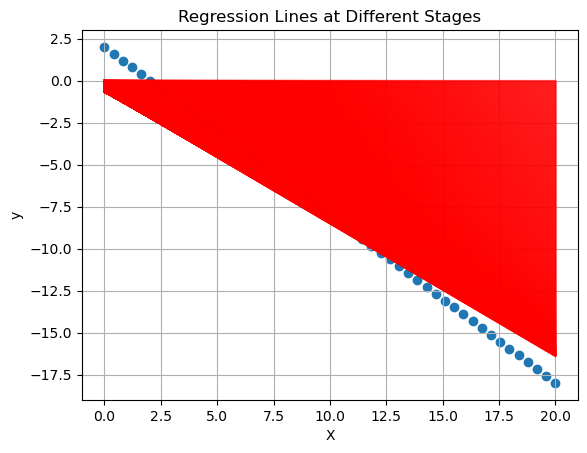

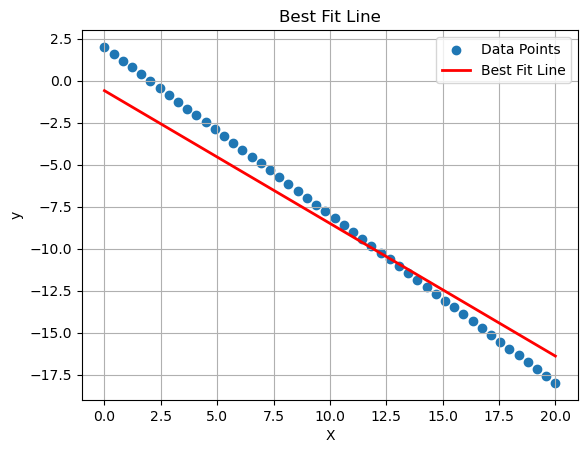

In [47]:
vis(X, y, y_pred, ts0, ts1, losses, lr=0.001)

##### The following results uses alpha = 0.001, beta1 = 0.9, beta2 = 0.5, epsilon =  1e-08, and max. iterations = 5000.

In [48]:
t0, t1, ts0, ts1, losses, h = adam(X, y, alpha = 0.001, beta1= 0.9, beta2= 0.5, itteration=5000)

********** Iteration 0 ********** 

h(x):
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0.]
Error Vector:
[-2.         -1.59183673 -1.18367347 -0.7755102  -0.36734694  0.04081633
  0.44897959  0.85714286  1.26530612  1.67346939  2.08163265  2.48979592
  2.89795918  3.30612245  3.71428571  4.12244898  4.53061224  4.93877551
  5.34693878  5.75510204  6.16326531  6.57142857  6.97959184  7.3877551
  7.79591837  8.20408163  8.6122449   9.02040816  9.42857143  9.83673469
 10.24489796 10.65306122 11.06122449 11.46938776 11.87755102 12.28571429
 12.69387755 13.10204082 13.51020408 13.91836735 14.32653061 14.73469388
 15.14285714 15.55102041 15.95918367 16.36734694 16.7755102  17.18367347
 17.59183673 18.        ]
J = 49.34693877551021
theta_0_grad: 8.0
theta_1_grad: 114.69387755102042
theta_0_new : -0.00099999999875
theta_1_new : -0.0009999999999128113

********** Iteration 1 ********** 

h(

In [49]:
y_pred = t0 + t1 * X
print(f"r2_score = {r2_score(y, y_pred)}")

r2_score = 0.944245878919177


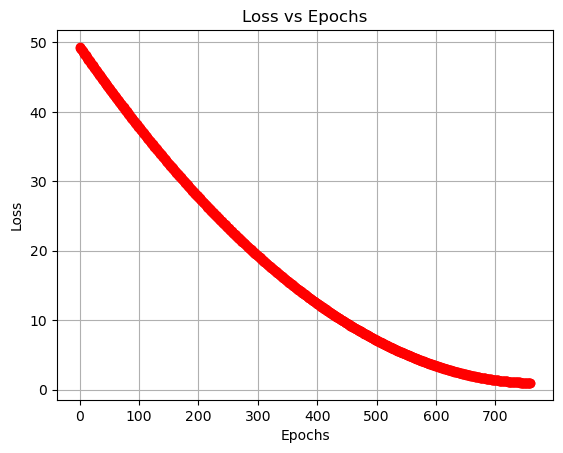

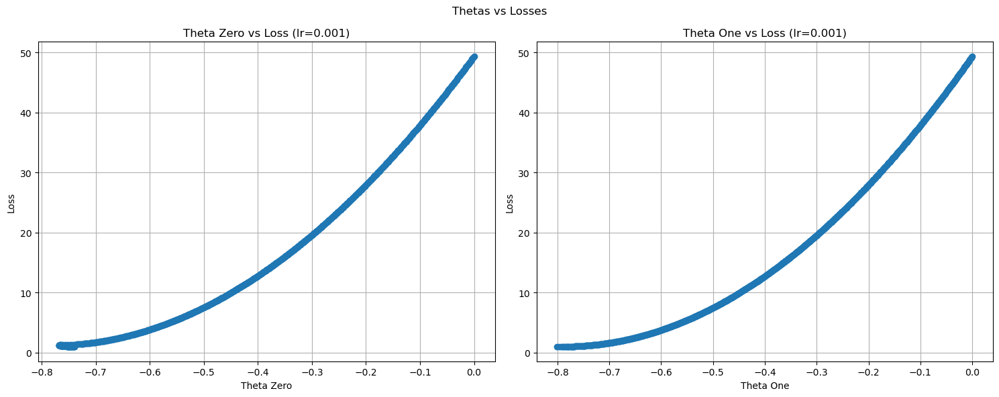

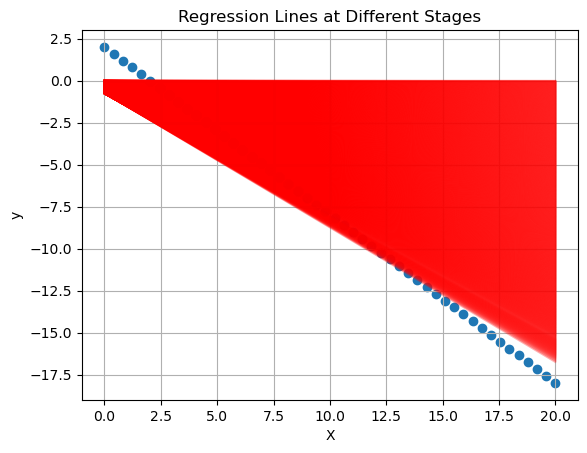

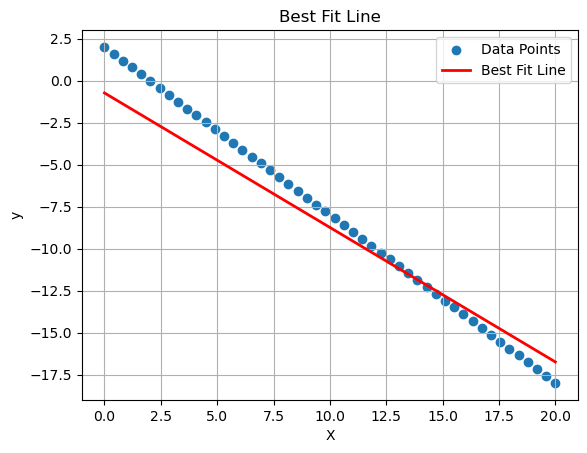

In [50]:
vis(X, y, y_pred, ts0, ts1, losses, lr=0.001)

##### The following results uses alpha = 0.001, beta1 = 0.5, beta2 = 0.99, epsilon =  1e-08, and max. iterations = 5000.

In [51]:
t0, t1, ts0, ts1, losses, h = adam(X, y, alpha = 0.001, beta1= 0.5, beta2= 0.9, itteration=5000)

********** Iteration 0 ********** 

h(x):
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0.]
Error Vector:
[-2.         -1.59183673 -1.18367347 -0.7755102  -0.36734694  0.04081633
  0.44897959  0.85714286  1.26530612  1.67346939  2.08163265  2.48979592
  2.89795918  3.30612245  3.71428571  4.12244898  4.53061224  4.93877551
  5.34693878  5.75510204  6.16326531  6.57142857  6.97959184  7.3877551
  7.79591837  8.20408163  8.6122449   9.02040816  9.42857143  9.83673469
 10.24489796 10.65306122 11.06122449 11.46938776 11.87755102 12.28571429
 12.69387755 13.10204082 13.51020408 13.91836735 14.32653061 14.73469388
 15.14285714 15.55102041 15.95918367 16.36734694 16.7755102  17.18367347
 17.59183673 18.        ]
J = 49.34693877551021
theta_0_grad: 8.0
theta_1_grad: 114.69387755102042
theta_0_new : -0.00099999999875
theta_1_new : -0.0009999999999128113

********** Iteration 1 ********** 

h(

In [52]:
y_pred = t0 + t1 * X
print(f"r2_score = {r2_score(y, y_pred)}")

r2_score = 0.9492244935925512


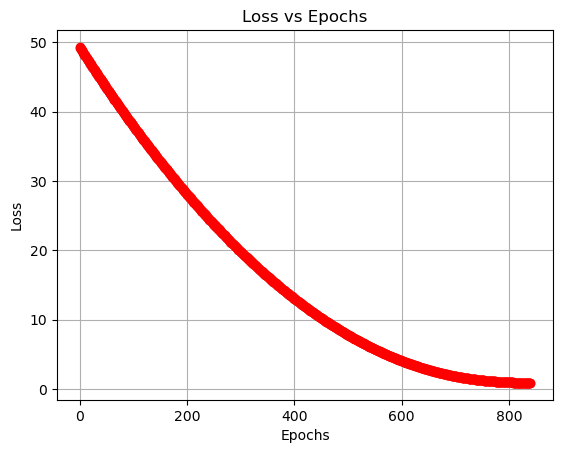

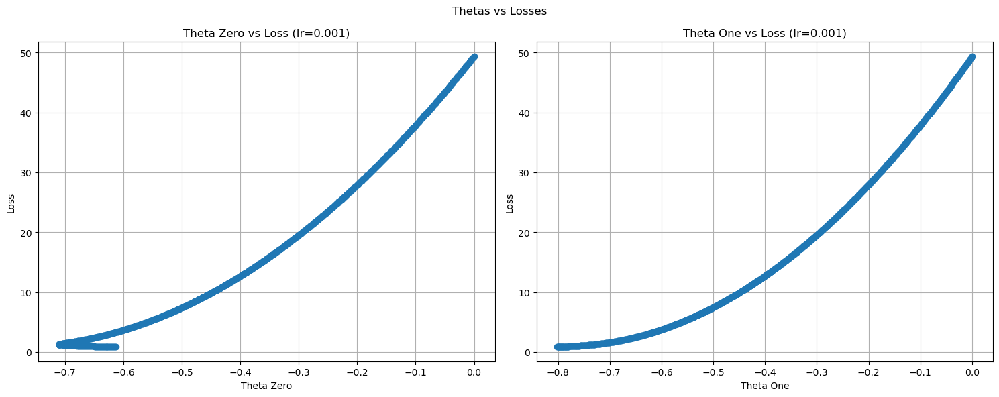

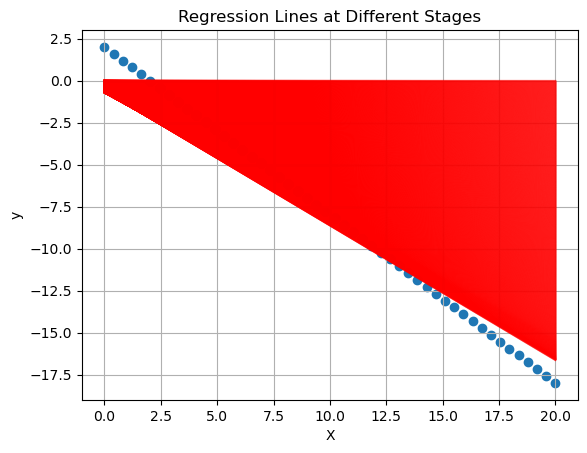

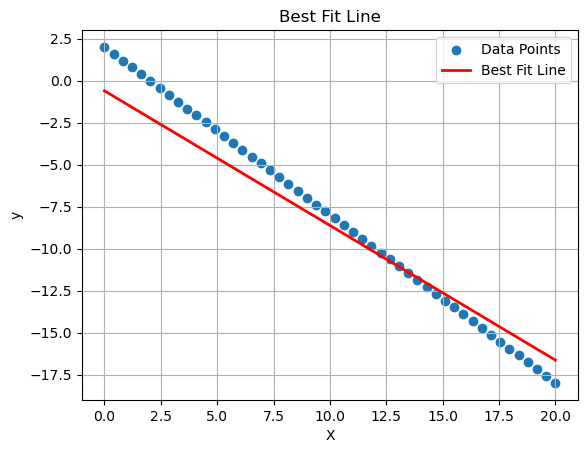

In [53]:
vis(X, y, y_pred, ts0, ts1, losses, lr=0.001)

##### The following results uses alpha = 0.001, beta1 = 0.5, beta2 = 0.5, epsilon =  1e-08, and max. iterations = 5000.

In [54]:
t0, t1, ts0, ts1, losses, h = adam(X, y, alpha = 0.001, beta1= 0.5, beta2= 0.5, itteration=5000)

********** Iteration 0 ********** 

h(x):
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0.]
Error Vector:
[-2.         -1.59183673 -1.18367347 -0.7755102  -0.36734694  0.04081633
  0.44897959  0.85714286  1.26530612  1.67346939  2.08163265  2.48979592
  2.89795918  3.30612245  3.71428571  4.12244898  4.53061224  4.93877551
  5.34693878  5.75510204  6.16326531  6.57142857  6.97959184  7.3877551
  7.79591837  8.20408163  8.6122449   9.02040816  9.42857143  9.83673469
 10.24489796 10.65306122 11.06122449 11.46938776 11.87755102 12.28571429
 12.69387755 13.10204082 13.51020408 13.91836735 14.32653061 14.73469388
 15.14285714 15.55102041 15.95918367 16.36734694 16.7755102  17.18367347
 17.59183673 18.        ]
J = 49.34693877551021
theta_0_grad: 8.0
theta_1_grad: 114.69387755102042
theta_0_new : -0.00099999999875
theta_1_new : -0.0009999999999128113

********** Iteration 1 ********** 

h(

In [55]:
y_pred = t0 + t1 * X
print(f"r2_score = {r2_score(y, y_pred)}")

r2_score = 0.9475845101116701


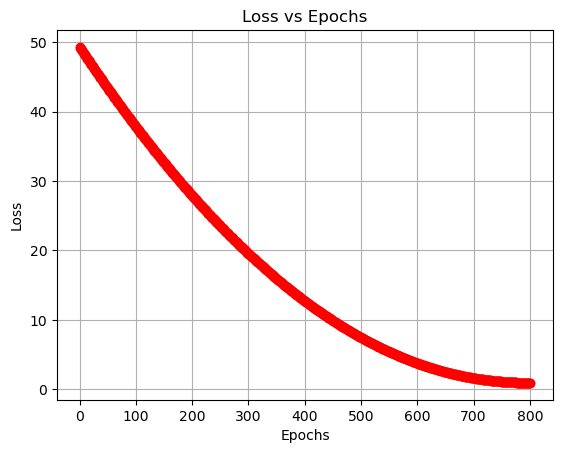

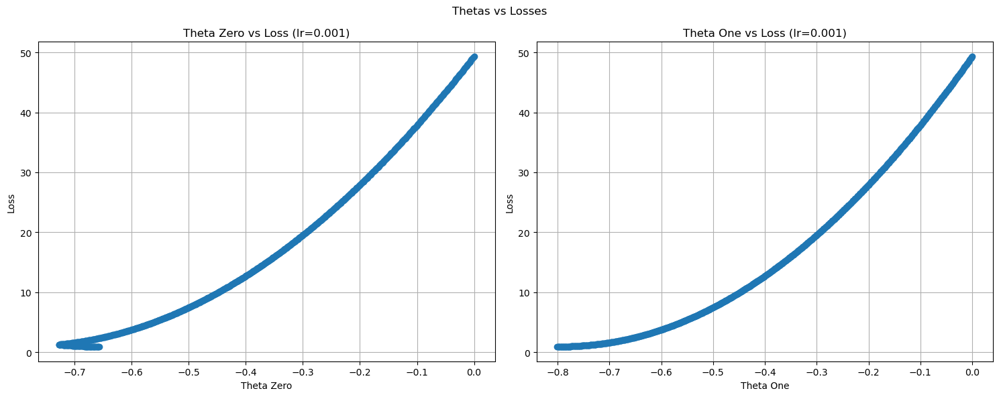

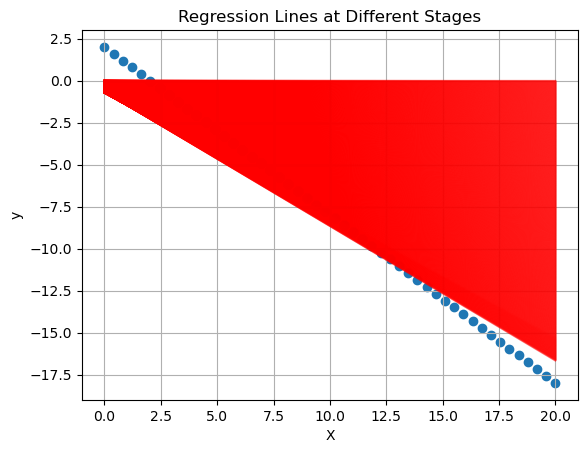

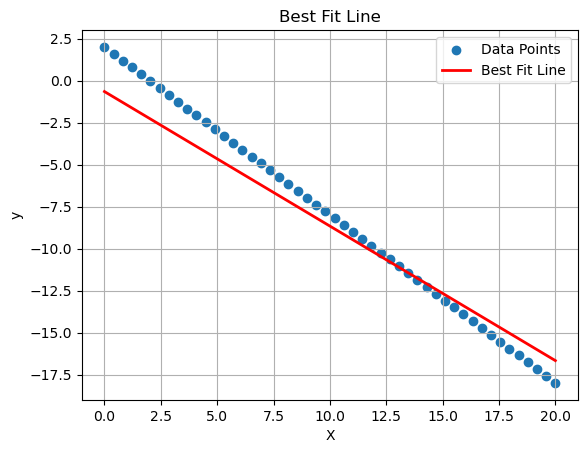

In [56]:
vis(X, y, y_pred, ts0, ts1, losses, lr=0.001)

##### The following results uses alpha = 0.01, beta1 = 0.9, beta2 = 0.99, epsilon =  1e-08, and max. iterations = 5000.

In [57]:
t0, t1, ts0, ts1, losses, h = adam(X, y, alpha = 0.01, beta1= 0.9, beta2= 0.99, itteration=5000)

********** Iteration 0 ********** 

h(x):
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0.]
Error Vector:
[-2.         -1.59183673 -1.18367347 -0.7755102  -0.36734694  0.04081633
  0.44897959  0.85714286  1.26530612  1.67346939  2.08163265  2.48979592
  2.89795918  3.30612245  3.71428571  4.12244898  4.53061224  4.93877551
  5.34693878  5.75510204  6.16326531  6.57142857  6.97959184  7.3877551
  7.79591837  8.20408163  8.6122449   9.02040816  9.42857143  9.83673469
 10.24489796 10.65306122 11.06122449 11.46938776 11.87755102 12.28571429
 12.69387755 13.10204082 13.51020408 13.91836735 14.32653061 14.73469388
 15.14285714 15.55102041 15.95918367 16.36734694 16.7755102  17.18367347
 17.59183673 18.        ]
J = 49.34693877551021
theta_0_grad: 8.0
theta_1_grad: 114.69387755102042
theta_0_new : -0.0099999999875
theta_1_new : -0.009999999999128114

********** Iteration 1 ********** 

h(x)

In [58]:
y_pred = t0 + t1 * X
print(f"r2_score = {r2_score(y, y_pred)}")

r2_score = 0.9952892444628807


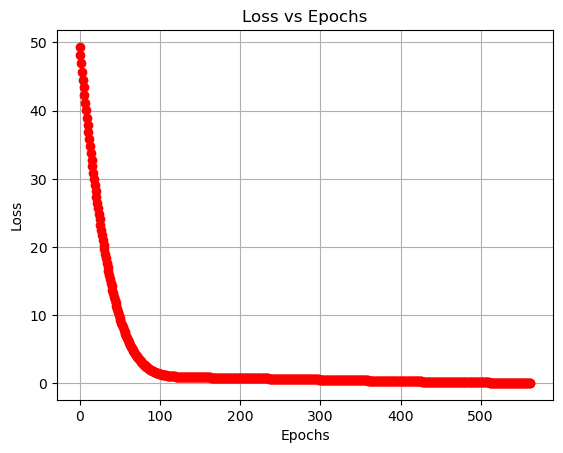

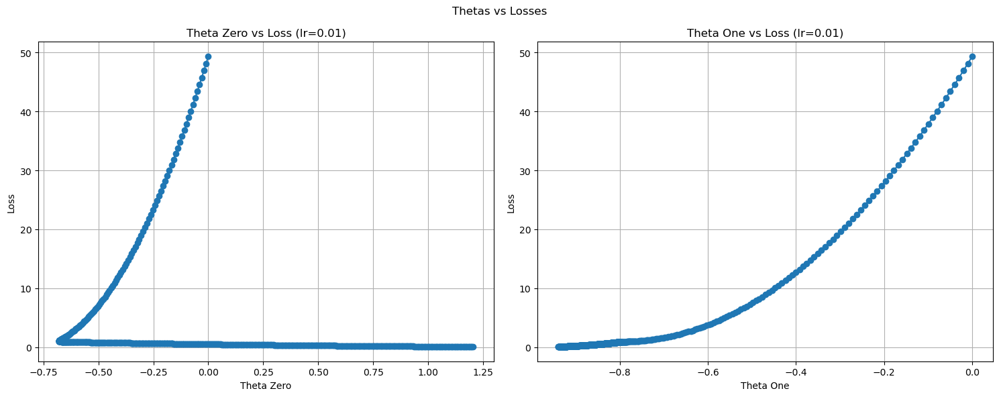

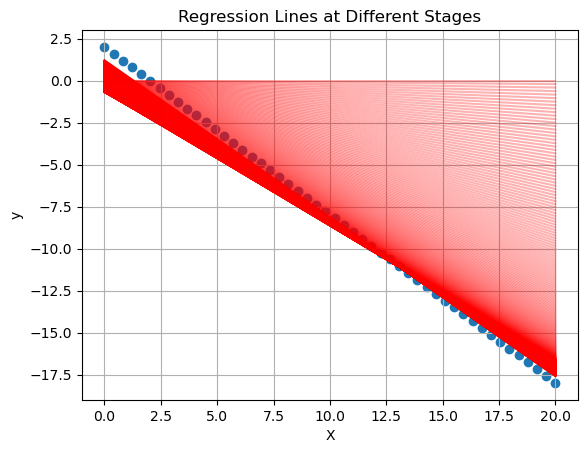

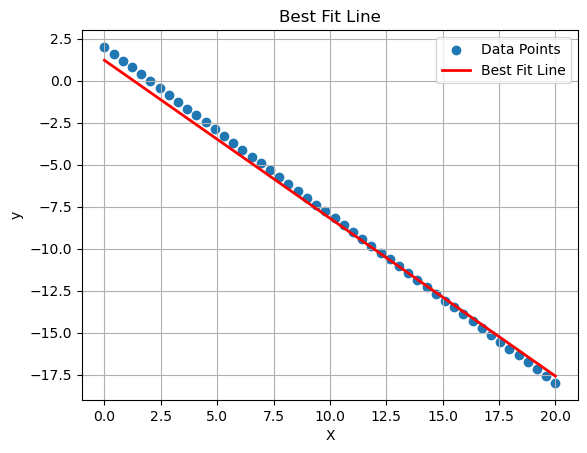

In [59]:
vis(X, y, y_pred, ts0, ts1, losses, lr=0.01)

## Congratulations 
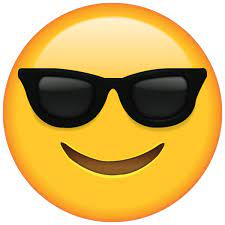